The power spectrum of the image generated by the function fBm (the varible fbm in the code) is compared with two other images. The fisrt image (the varible fbmm in the code) is constructed by separating the scales of fbm and imposing standed deviation equal to 0.5 for all the scales and reconstruction, as seen in the results this is an effictive way to change fourier power law. The second image (the variable fb in the code) is constructed by exponentiating the first image after changing the total standard deviation by the factor $\zeta=0.2$, the results show that the log-normal image shows no significant change in fourier power law; however, for the second image the non-gaussian part dominates fourier's power law (at least for the small scales) unlike the first image. 


As a preliminary conclusions, manipulating the standard deviations of the scales' pdfs (and **not the mean**) is the way to change the power law. Changing the pdf of the total image from normal to log-normal distribution doesn't change the power law, this is consisant with the fact that fourier power spectrum is compared to the **second order structure function** which is not sensetive to turbulence intermittency. However, the fact that the non-gaussian part is dominant in the second image suggests that turbulence intermittency can be seen through the **power law of the non-caussian part of the small scales**.

Before proceeding the role played by the standard deviation in changing the power law should be further understood.

## Importing the pywavan functions along with the required liberaries

In [1]:
%pylab inline
from pywavan import fbm2d
from pywavan import powspec
from pywavan import imsmooth
from pywavan import fan_trans
from pywavan import tauq
from pywavan import Dh
from pywavan import angluarPS
import itertools
from scipy.stats import linregress
from scipy import interpolate

Populating the interactive namespace from numpy and matplotlib


## Generating the normally-distributed image

In [2]:
#Create a nx X ny pixels map with a power law gamma
nx = 512
ny = 512
gamma = 0

#stdfbm=0.1
fbm= fbm2d(gamma, ny,nx)
#fbm= fbm2d(gamma, ny,nx)*stdfbm

#Calculate the fbm image Fourier power spectrum 
tab_k, spec_kfbm = powspec(fbm, reso=1.)

#wt, S11a, wav_k, S1a, q = fan_trans(fbm, reso=1, q=0, qdyn=False)
wt, S11a, wav_k, S1a, q = fan_trans(fbm, reso=1, q=0, qdyn=False, angular=True)
M=np.size(wav_k)
q=[]
q=[2.9]*M

In [3]:
#q=[]
#q=[2.9]*M
#wt, S11a, wav_k, S1a, q = fan_trans(fbm, reso=1, q=q, qdyn=True, skewl=0.4)
    
#for i in range(wav_k)
    #kk=wt[i+M,:,:].real+wt[i+M,:,:].real

0
1
2
3
4
5
6
7
8
9
10


Text(0.5, 1.0, 'Multiplicative model')

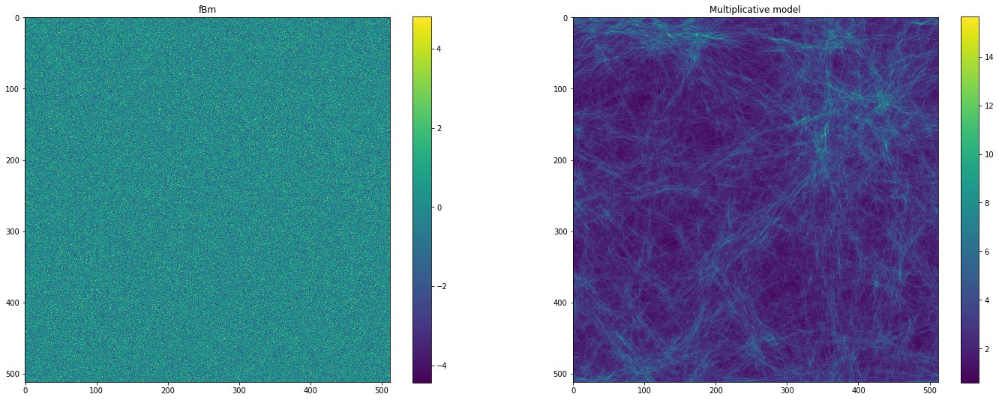

In [3]:
ffbm=np.zeros((ny,nx))
fb1=np.zeros((ny,nx))
j=np.zeros(np.size(wav_k))
mf1=np.linspace(0.07,0.07,np.size(wav_k))
gg=np.linspace(1,1,wt.shape[1])
gg[1]=1


for j in range(wt.shape[1]):
#for j in range(3,4):
    print(j)
    fbmm=np.ones((ny,nx))
    #figure(figsize=(9,9))    
    for i in range(np.size(wav_k)):
        
        x=np.real(wt[i,j,:,:])
        #print(np.std(x))
        x=x/np.std(x)*0.1
        x=np.exp(x)
        #mergedfb  = list(itertools.chain.from_iterable(x))
        #plt.hist(mergedfb,bins='auto', label=i)
        #figure(figsize=(9,9))
        #imshow(x)
        fbmm=fbmm*(x)
        #figure(figsize=(9,9))
        #imshow(fbmm)
        #print(np.min(x))
        #fbmm=fbmm+x
    fb1=fb1+gg[j]*fbmm
    #plt.legend()
    #plt.show()
fb1=0.2*fb1
fb=fb1

figure(figsize=(24,9))
plt.subplot(1,2,1)
imshow(fbm)
colorbar()
plt.title('fBm')
plt.subplot(1,2,2)
imshow(fb1)
colorbar()
plt.title('Multiplicative model')

In [4]:
wtfb1, S11a1, wav_k, S1afb1, q = fan_trans(fb1, reso=1, q=0, qdyn=True, skewl=0.4)

Text(0.5, 1.0, 'Modified power law')

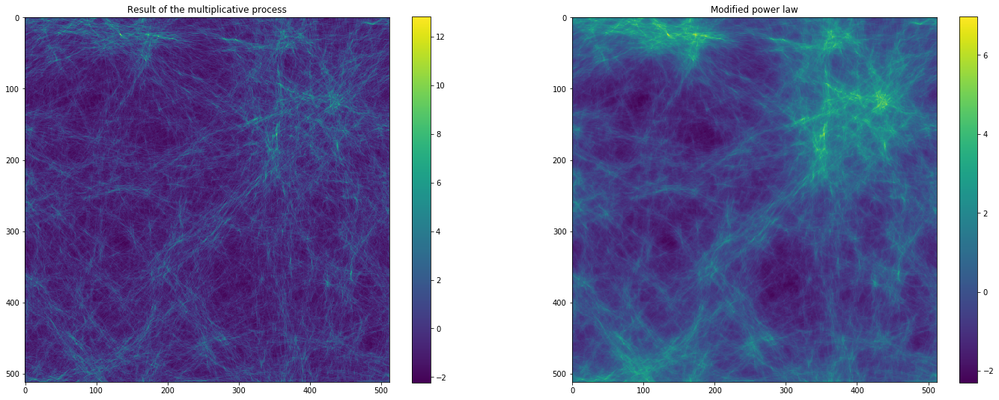

In [5]:
fb=np.zeros((ny,nx))

mf=np.linspace(3,1,np.size(wav_k))

'''
for ii in range(5):
    mf[np.size(wav_k)-(ii+1)]=0.9


#ang=np.ones((np.size(wav_k),np.size(wt,axis=1)))


for ii in range(10):
    ang[ii,2]=5


#ang=np.random.rand(np.size(wav_k),np.size(wt,axis=1))
#ang=np.random.rand(np.size(wt,axis=1))+1

for ii in range(10):
    ang[ii,2]=1



for ii in range(5):
    
    x=np.real(wt[ii,:,:])
    #x=exp(2*(x+2))
    #x=x-np.mean(x)
    x=x+1
    fb=fb*x
for i in range(5,np.size(wav_k)):

'''
for i in range(np.size(wav_k)):
    ''' 
    x=np.zeros((ny,nx))
    for j in range(np.size(wt,axis=1)):
        y=wt[i,j,:,:].real
        y=y*ang[i,j]
        #y=y*ang[j]
        x=x+y
    #print(np.mean(x))
    #x=np.abs(wt[i,:,:])
    #print(np.mean(x))
    '''
    
    x=np.real(wtfb1[i,:,:])
    # Changing the mean doesn't change the power law
    fb=fb+x*exp(mf[i])
    #fbmm=fbmm+x
    
    '''
    ffbm=ffbm+wt[i,:,:].real
    figure(figsize=(24,9))
    plt.subplot(1,2,1)
    imshow(fbmm)
    colorbar()
    plt.subplot(1,2,2)
    imshow(ffbm)
    colorbar()
    #'''

fb=0.1*fb

figure(figsize=(24,9))
plt.subplot(1,2,1)
imshow(fb1)
colorbar()
plt.title('Result of the multiplicative process')
plt.subplot(1,2,2)
imshow(fb)
colorbar()
plt.title('Modified power law')

In [6]:
    #fb=G.real+2*NG.real
    #Calculate the power spectrum of the total image
    tab_km, spec_km = powspec(fb1, reso=1.)
    tab_kfb, spec_kfb= powspec(fb, reso=1.)
    w,S=angluarPS(fb)
    
    #Calculate the Fan wavelet transforms
    #wtlog, S11a, wav_k, S1a, q = fan_trans(logfbm, reso=1, q=0, qdyn=False)

    #Set a list of q that are all starting at 2.5
    #The q parameter sets the "sensitivity" to non-Gaussianities in a distribution
    M=np.size(wav_k)
    
    q=[]
    q=[2.9]*M
    #Wavelet power spectrum where the q parameter is dynamic and will converge
    #to its optimal value as a function of scales and angles according to the skewness
    #of the wavelet coefficients distribution.
    #wtm, S11a, wav_km, S1am, q = fan_trans(fbmm, reso=1, q=q, qdyn=True, skewl=0.4)
    wtfb, S11a, wav_kfb, S1afb, q = fan_trans(fb, reso=1, q=q, qdyn=True, skewl=0.4)

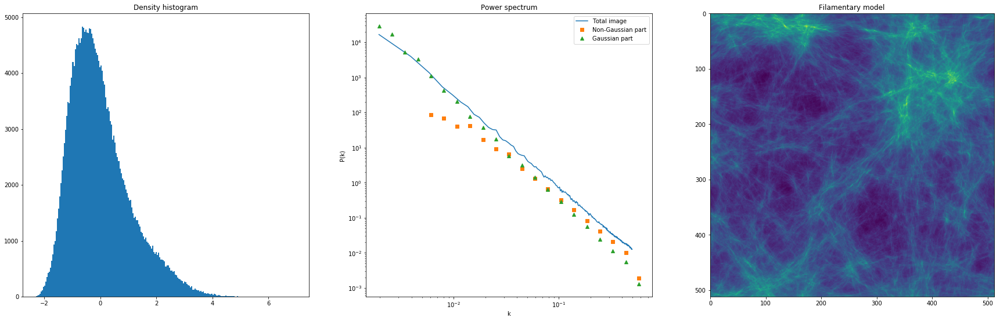

In [7]:
    '''
    l = (fb==0)
    mergedfb=fb[~l]
    '''
    
    #tab_km, spec_km = powspec(fb1, reso=1.)
    tab_kfb, spec_kfb= powspec(fb, reso=1.)
    
    mergedfb  = list(itertools.chain.from_iterable(fb))
    #mergedfbm  = list(itertools.chain.from_iterable(fbm))
    #mergedfbmm  = list(itertools.chain.from_iterable(fbmm))

    figure(figsize=(30,9))
    plt.subplot(1,3,1)
    plt.hist(mergedfb,bins='auto', label='Filamentary model')
    plt.title('Density histogram')
    plt.subplot(1,3,2)
    #plot(tab_k, spec_kfbm, label='Original fBm')
    #plot(tab_km, spec_km, label='multi. model')
    plot(tab_kfb, spec_kfb, label='Total image')
    plot(wav_kfb, S1afb[1,:], 's', label='Non-Gaussian part')
    plot(wav_kfb, S1afb[2,:], '^', label='Gaussian part')
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel('k')
    plt.ylabel('P(k)')
    plt.legend()
    plt.title('Power spectrum')
    plt.subplot(1,3,3)
    imshow(fb)
    plt.title('Filamentary model')
    plt.show()


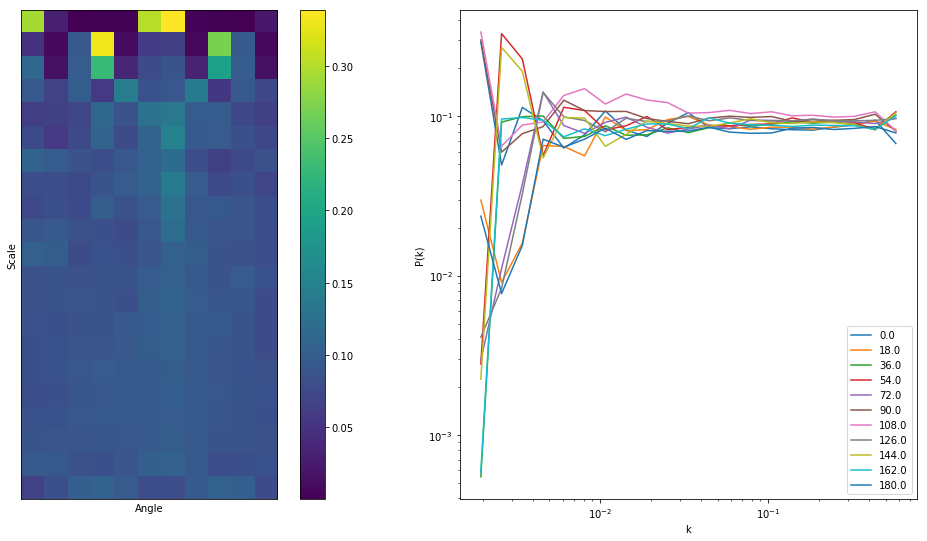

In [8]:
figure(figsize=(18,9))
plt.subplot(1,2,1)
imshow(S)
colorbar()
plt.xlabel('Angle')
plt.ylabel('Scale')
plt.xticks(np.arange(0, 0,0.1))
plt.yticks(np.arange(0, 0,0.1))
plt.subplot(1,2,2)
for i in range(0,S.shape[1]):
    plot(w,S[:,i], label=180/10*(i))
plt.xscale('log')
plt.yscale('log')
plt.xlabel('k')
plt.ylabel('P(k)')
plt.legend()
plt.show()


Text(0.5, 1.0, 'Homogeneous part (G)')

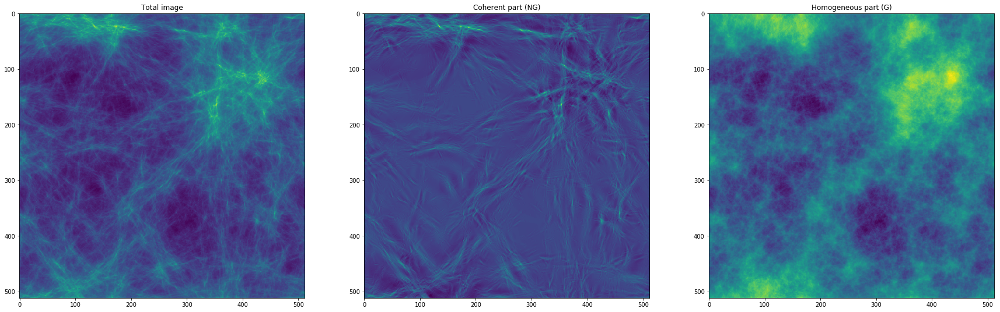

In [9]:
G=np.zeros((ny,nx))
NG=np.zeros((ny,nx))
for i in range(np.size(wav_kfb)):
    G=G+wtfb[i+2*np.size(wav_k),:,:]
    NG=NG+wtfb[i+np.size(wav_k),:,:]


figure(figsize=(30,9))
plt.subplot(1,3,1)
imshow(fb)
plt.title('Total image')
plt.subplot(1,3,2)
imshow(NG.real)
plt.title('Coherent part (NG)')
plt.subplot(1,3,3)
imshow(G.real)
plt.title('Homogeneous part (G)')

In [36]:
H=range(-1,6)
#q=0
tau, S1, wav_k, ab = tauq(fb, q=q,H=H,kmaxscale=0.01,kminscale=0.1)

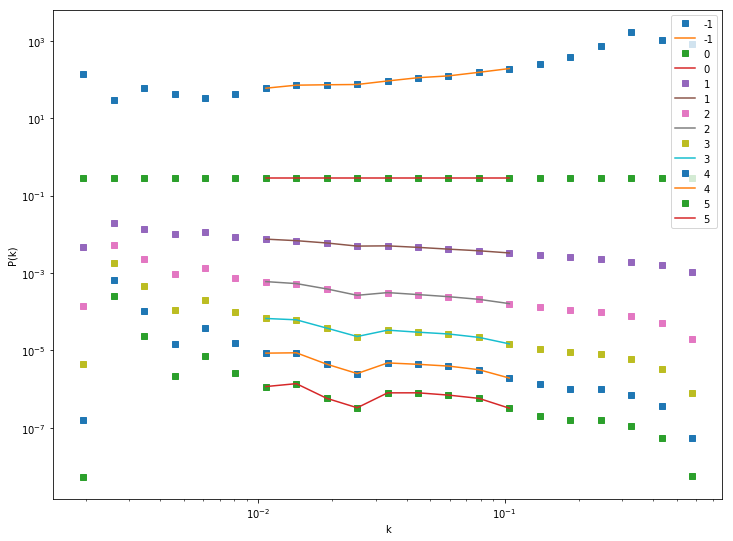

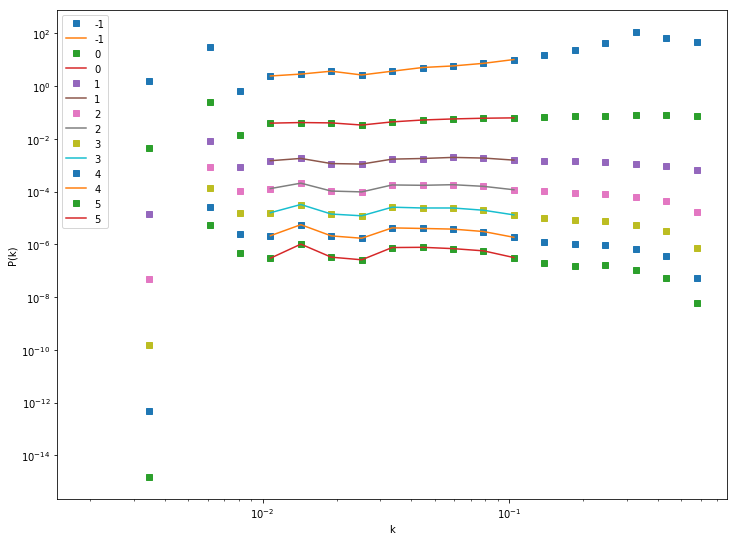

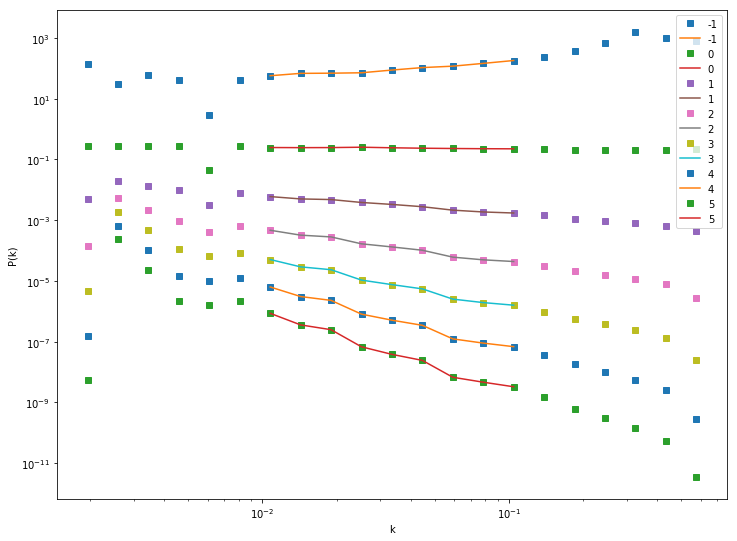

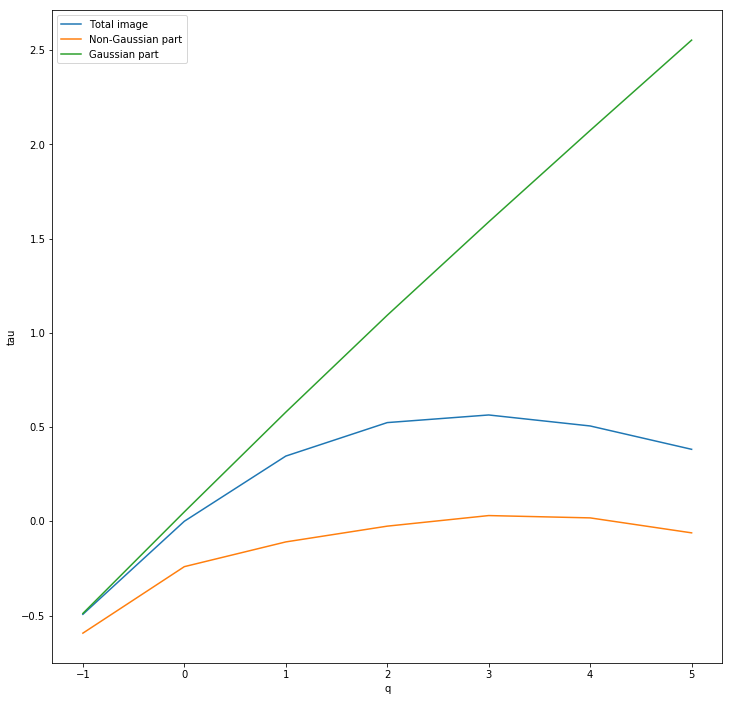

In [101]:
#Use this cell to plot if q!=0
figure(figsize=(12,9))

for i in range(0,np.size(H)):
    
    plot(wav_k, S1[0,i],'s', label=H[i])
    plot(wav_k[ab], S1[0,i,ab], label=H[i])
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel('k')
    plt.ylabel('P(k)')
    plt.legend()

figure(figsize=(12,9))

for i in range(0,np.size(H)):
    
    plot(wav_k, S1[1,i],'s', label=H[i])
    plot(wav_k[ab], S1[1,i,ab], label=H[i])
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel('k')
    plt.ylabel('P(k)')
    plt.legend()

figure(figsize=(12,9))
    
for i in range(0,np.size(H)):
    
    plot(wav_k, S1[2,i],'s', label=H[i])
    plot(wav_k[ab], S1[2,i,ab], label=H[i])
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel('k')
    plt.ylabel('P(k)')
    plt.legend()

figure(figsize=(12,12))
plot(H,-tau[0,:],label='Total image')
plot(H,-tau[1,:],label='Non-Gaussian part')
plot(H,-tau[2,:],label='Gaussian part')
plt.xlabel('q')
plt.ylabel('tau')
plt.legend()

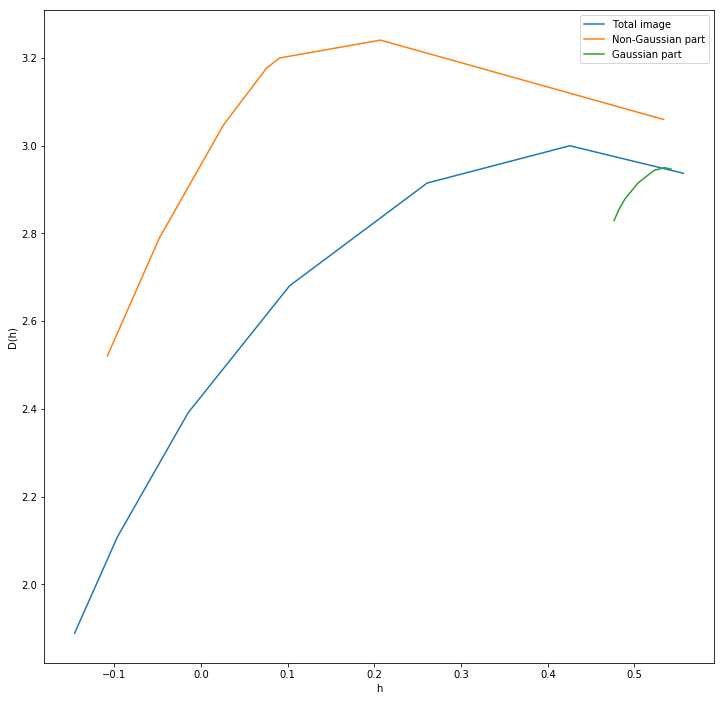

In [102]:
D1,h1 =Dh(H,-tau[0,:])
D2,h2 =Dh(H,-tau[1,:])
D3,h3 =Dh(H,-tau[2,:])
figure(figsize=(12,12))
plot(h1,D1,label='Total image')
plot(h2,D2,label='Non-Gaussian part')
plot(h3,D3,label='Gaussian part')
plt.xlabel('h')
plt.ylabel('D(h)')
plt.legend()

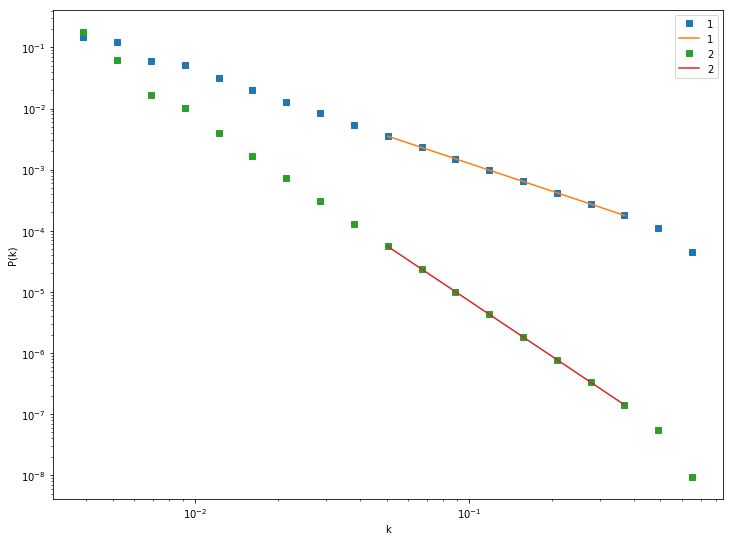

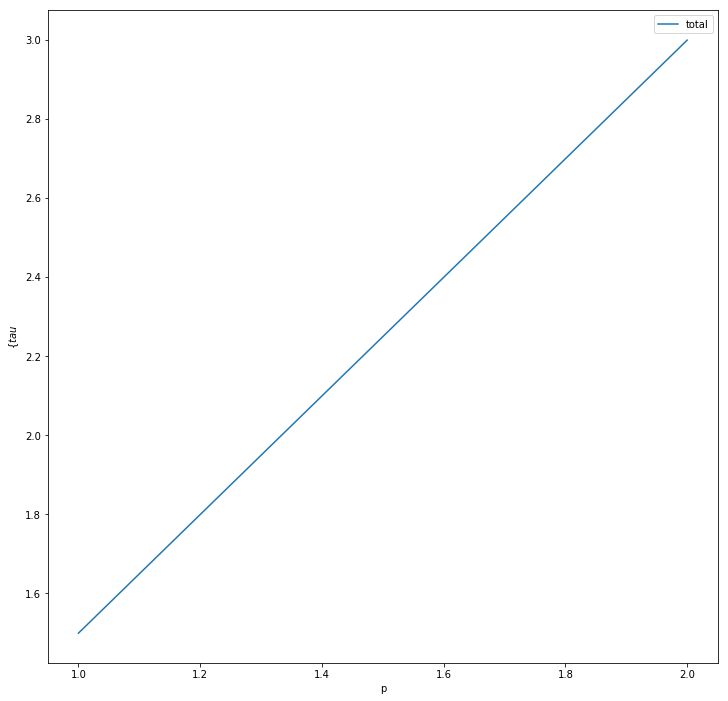

In [69]:
#Use this cell to plot if q=0

figure(figsize=(12,9))

for i in range(0,np.size(H)):
    
    plot(wav_k, S1[i,:],'s', label=H[i])
    plot(wav_k[ab], S1[i,ab], label=H[i])
    plt.xscale('log')
    plt.yscale('log')
    plt.xlabel('k')
    plt.ylabel('P(k)')
    plt.legend()
 
figure(figsize=(12,12))
plot(H,-tau,label='total')
plt.xlabel('p')
plt.ylabel('$\{tau}$')
plt.legend()

In [10]:
#Inversion cells

wti, S11a, wav_k, S1a, q = fan_trans(fb, reso=1, q=0 , qdyn=True, skewl=0.4, pownorm=False, angular=True)
N=wti.shape[1]    
M=np.size(wav_k)

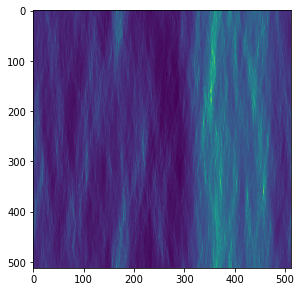

In [36]:
figure(figsize=(60,12))

for i in range(1):
        
    fbth=np.sum(wti[:,i,:,:].real,axis=0)     #the image for this specific angle
    fbth=fbth+np.abs(np.min(fbth))+1
    plt.subplot(1,N,i+1)
    imshow(fbth)
    

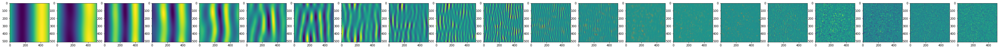

In [41]:
    fbth=log(fbth)
    
    wtth, S11a, wav_k, S1a, q = fan_trans(fbth, reso=1, q=0 , qdyn=True, skewl=0.4, pownorm=False, angular=False)
    
    figure(figsize=(60,12))
    for j in range(M):
        
        plt.subplot(1,M,j+1)
        imshow(wtth[j,:,:].real)
        

0.001953125


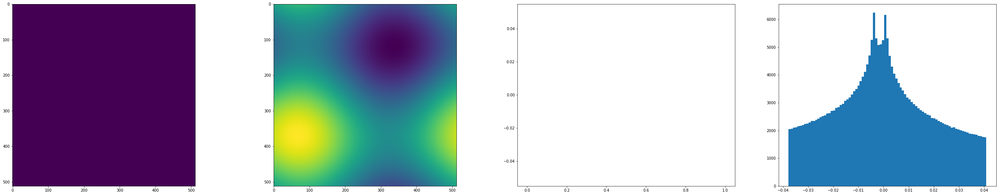

0.00259538886559


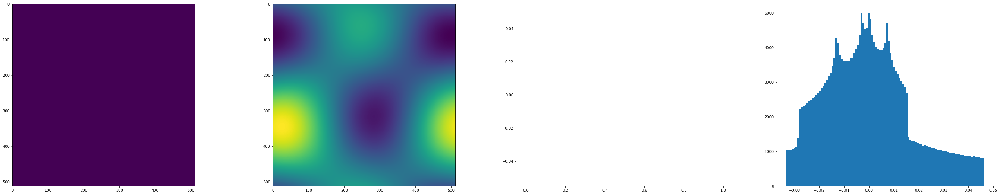

0.00344885420218


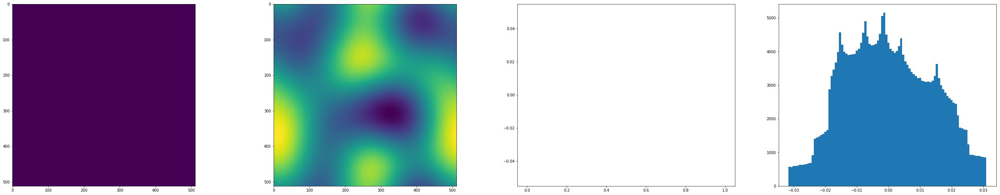

0.00458297231123


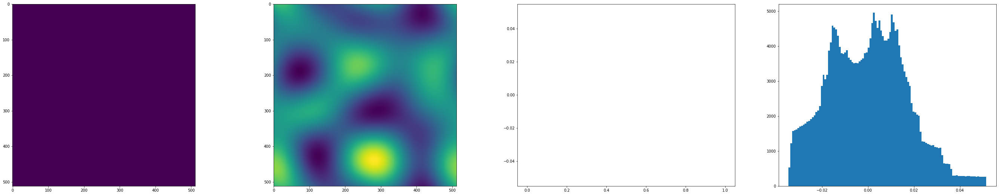

0.00609003279763


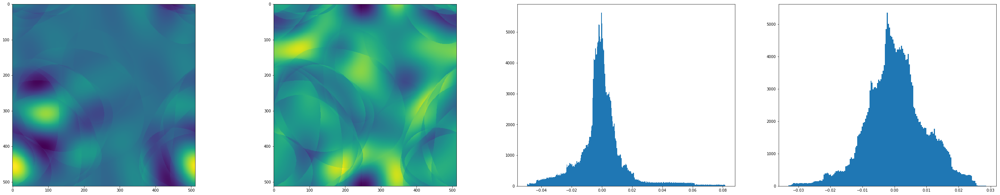

0.0080926736968


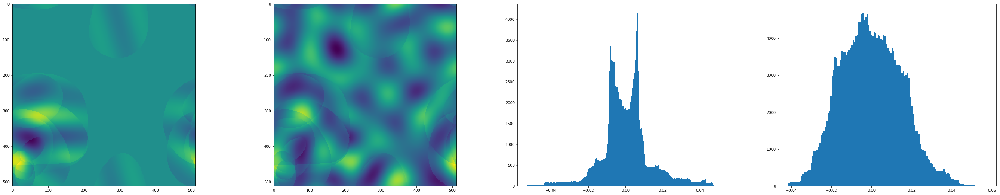

0.0107538612252


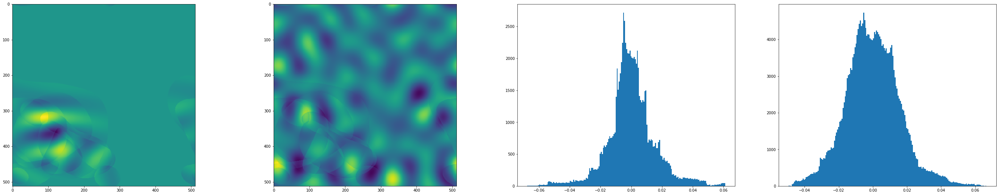

0.0142901512633


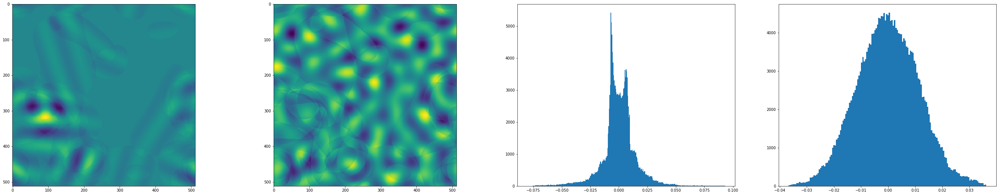

0.0189893117318


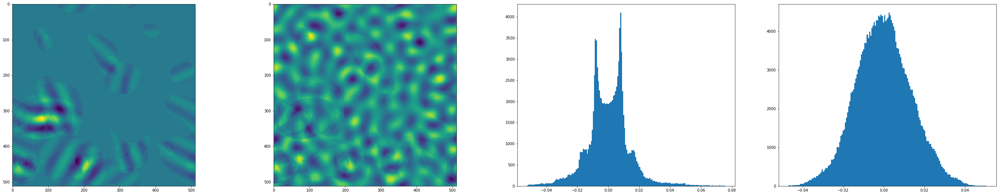

0.0252337398958


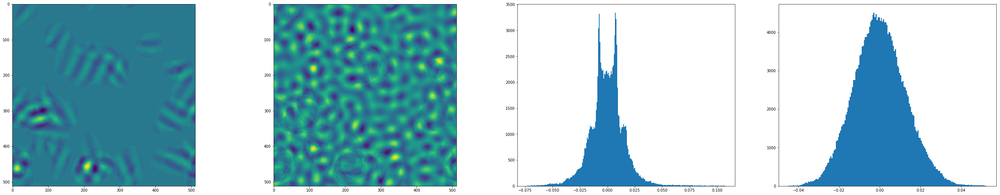

0.0335315801922


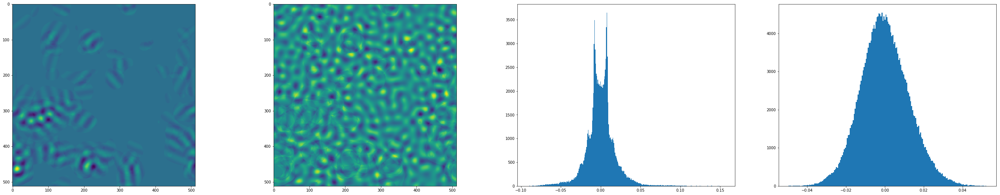

0.0445580748167


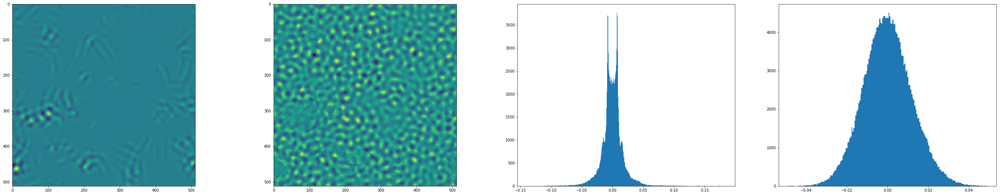

0.0592105120008


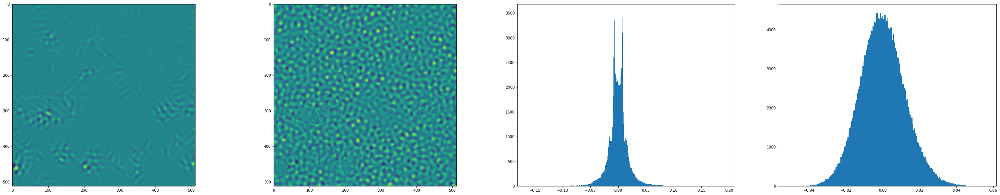

0.0786812434292


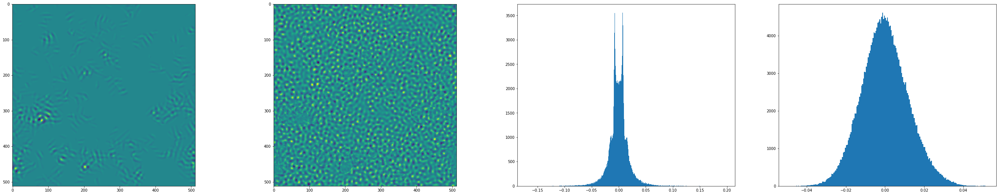

0.104554712641


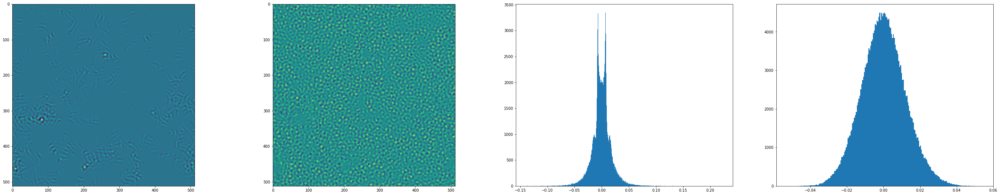

0.138936390161


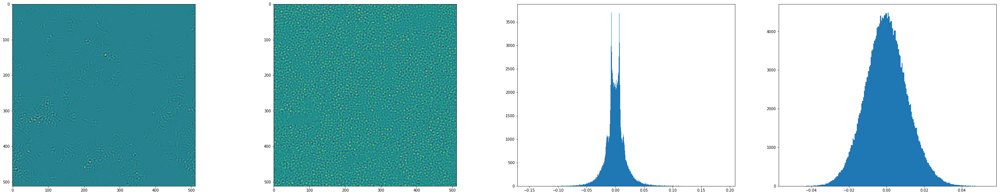

0.184624107545


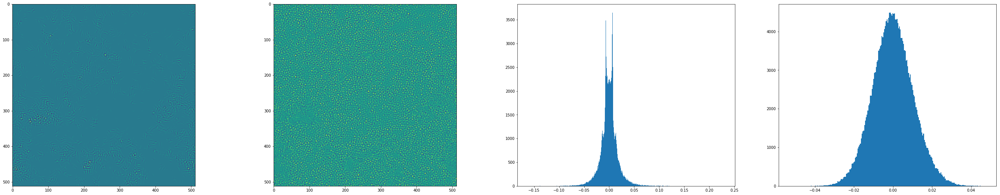

0.245335732758


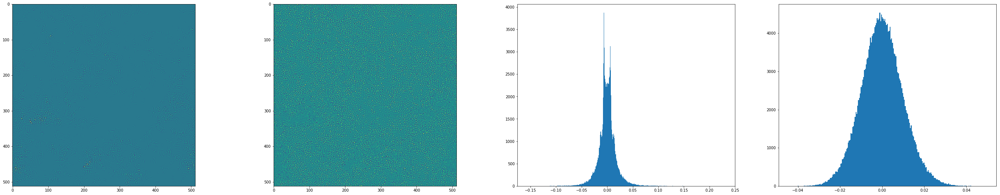

0.326011714115


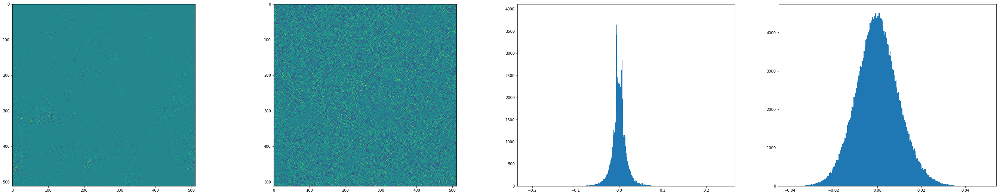

0.433217112507


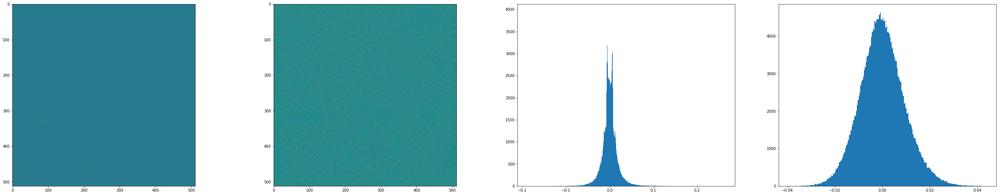

0.575675837535


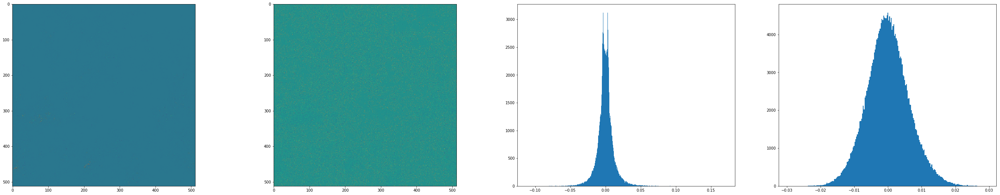

In [52]:
for i in range(np.size(wav_kfb)):
    print(wav_kfb[i])
    l = (wtfb[i+M,:,:].real==0)
    l1= (wtfb[i+2*M,:,:].real==0)
    hist = wtfb[i+M,~l].real
    hist1= wtfb[i+2*M,~l1].real
    
    figure(figsize=(48,9))
    plt.subplot(1,4,1)
    imshow(wtfb[i+M,:,:].real)
    plt.subplot(1,4,2)
    imshow(wtfb[i+2*M,:,:].real)
    plt.subplot(1,4,3)
    plt.hist(hist,bins='auto')
    #plt.axis([-2, 2, 0, 3000])
    plt.subplot(1,4,4)
    plt.hist(hist1,bins='auto')
    plt.show()

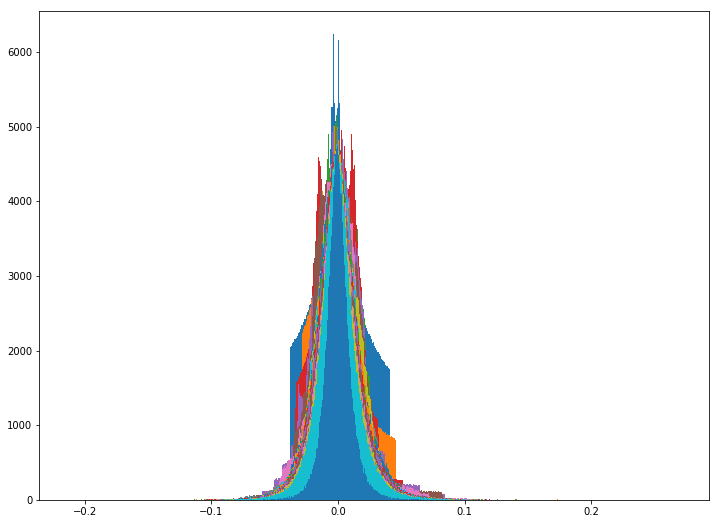

In [53]:
figure(figsize=(12,9))
for i in range(np.size(wav_kfb)):
    x=wtfb[i,:,:].real
    mergedx = list(itertools.chain.from_iterable(x))
    plt.hist(mergedx,bins='auto')


0.001953125


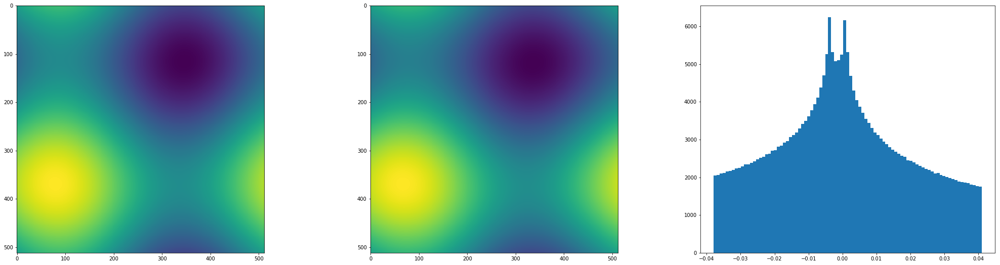

0.00259538886559


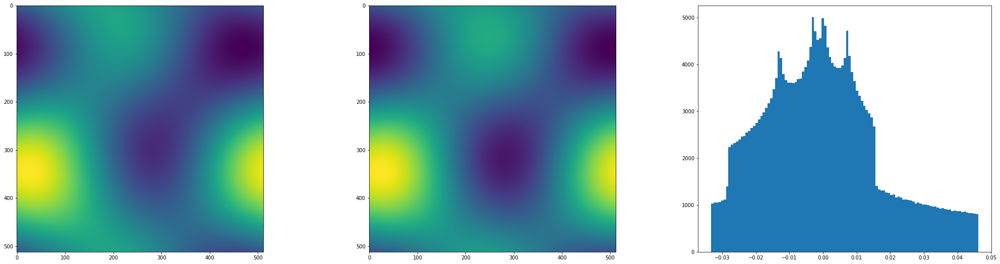

0.00344885420218


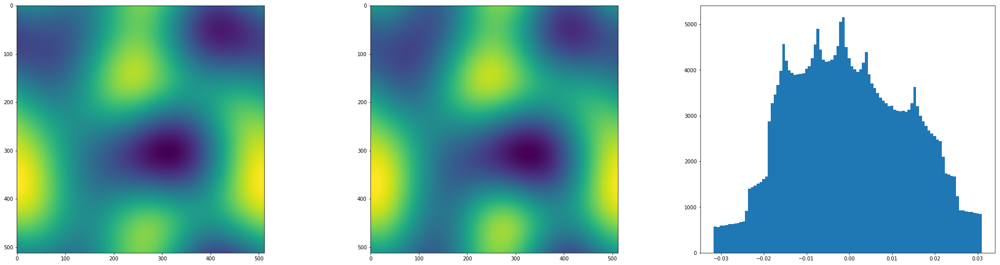

0.00458297231123


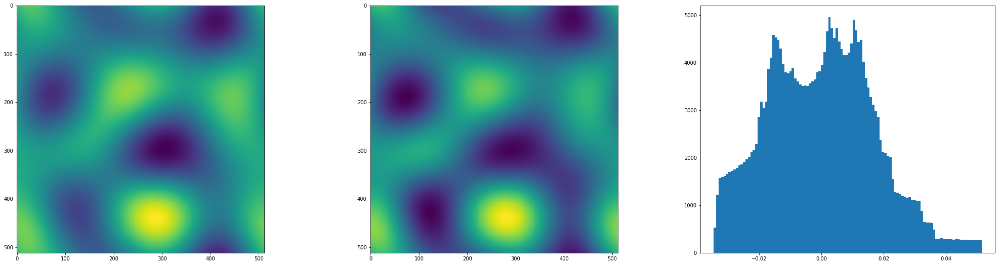

0.00609003279763


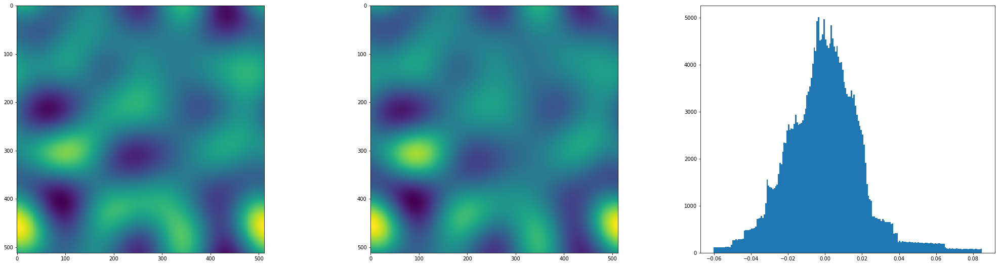

0.0080926736968


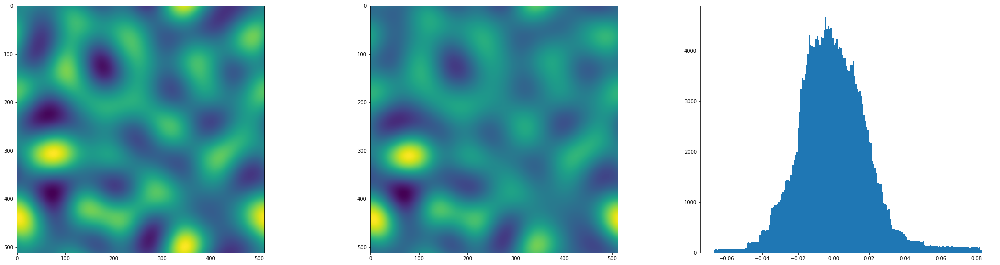

0.0107538612252


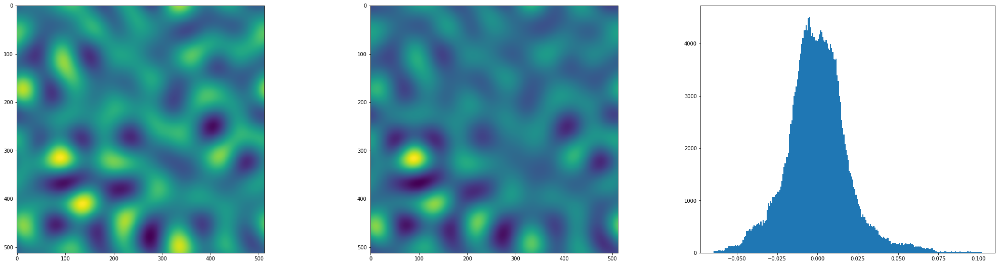

0.0142901512633


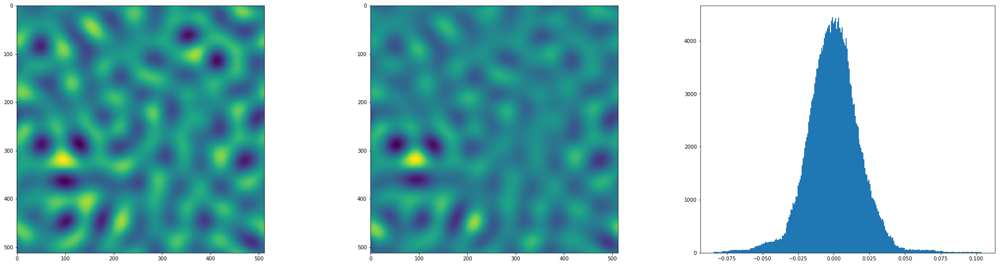

0.0189893117318


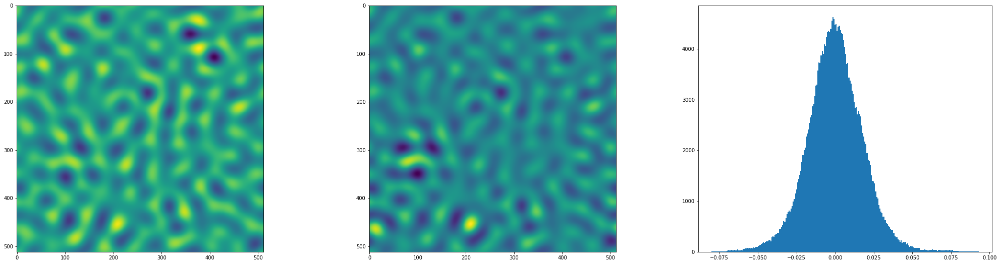

0.0252337398958


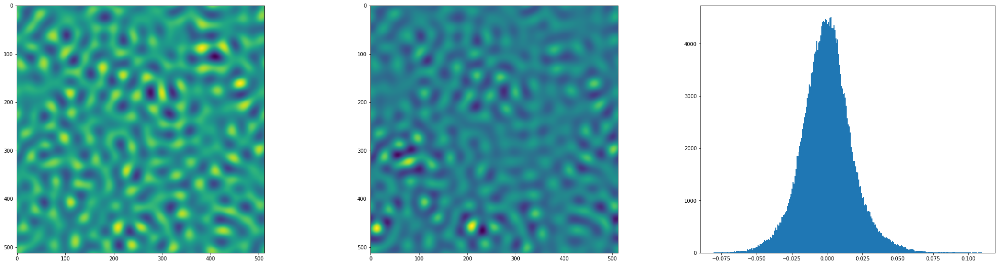

0.0335315801922


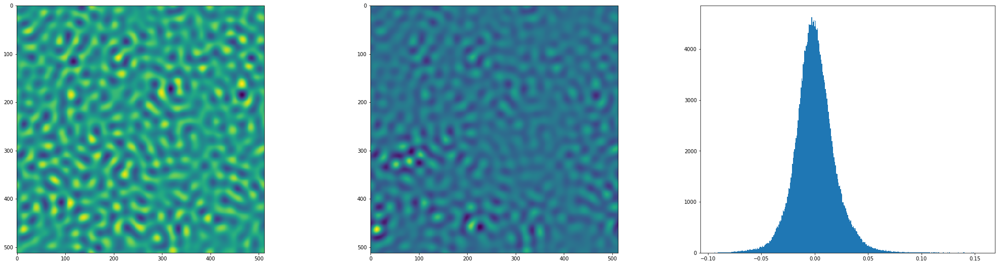

0.0445580748167


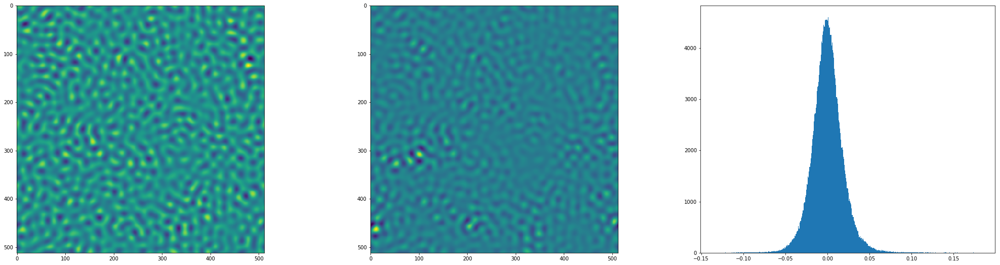

0.0592105120008


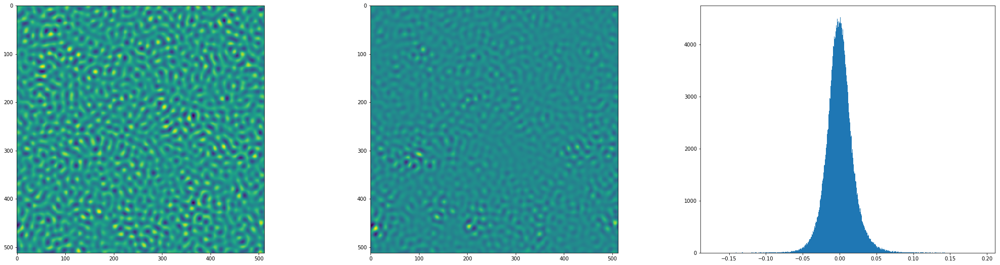

0.0786812434292


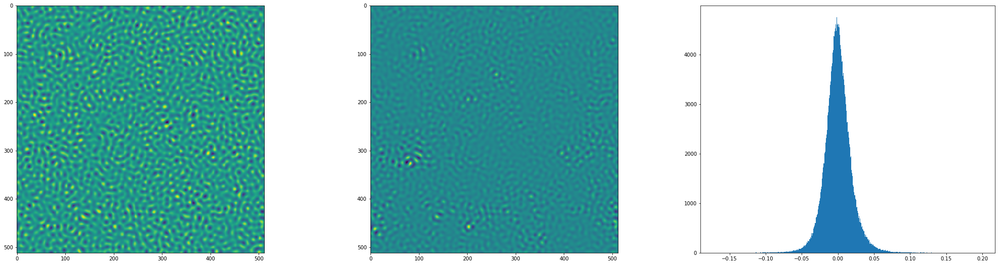

0.104554712641


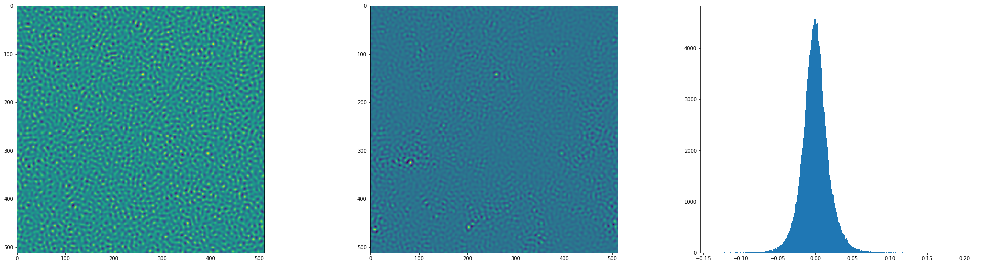

0.138936390161


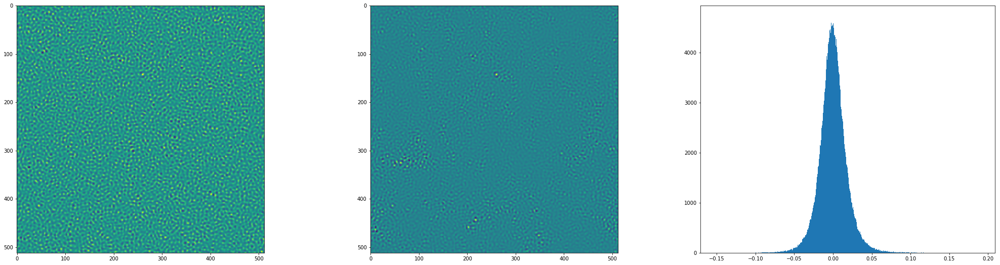

0.184624107545


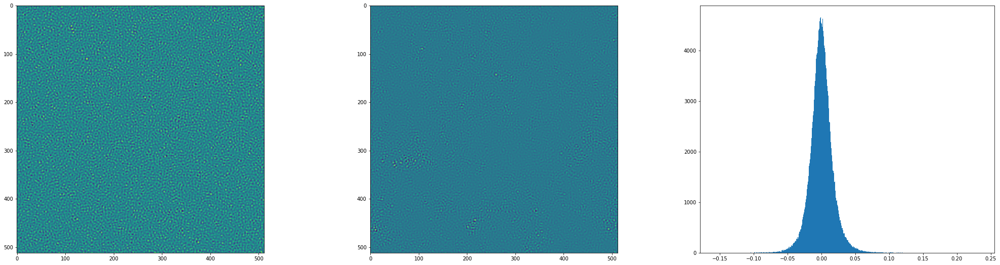

0.245335732758


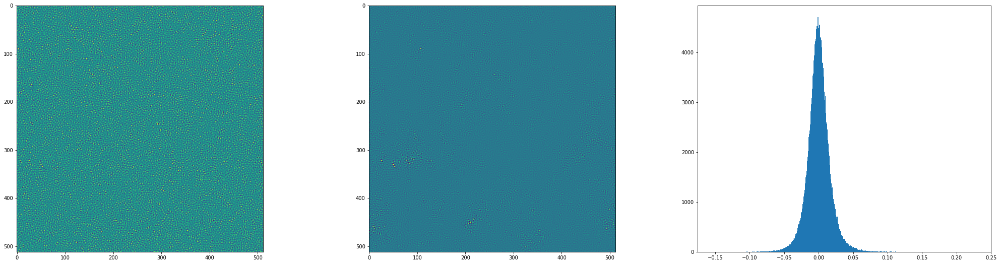

0.326011714115


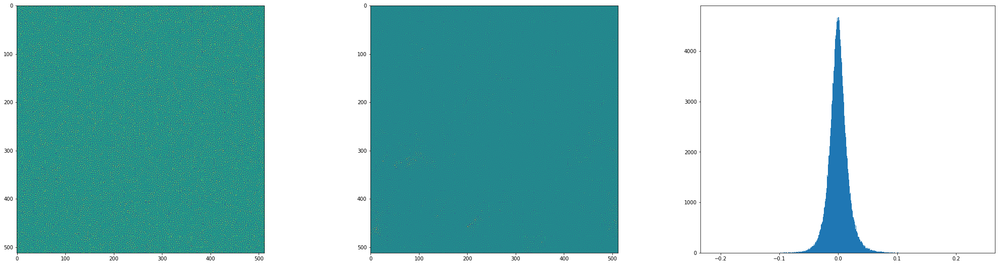

0.433217112507


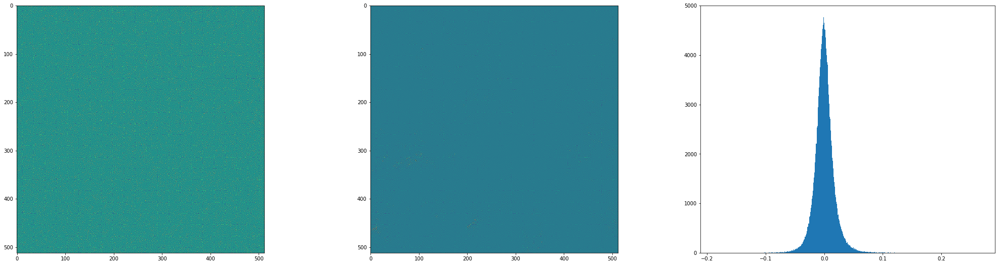

0.575675837535


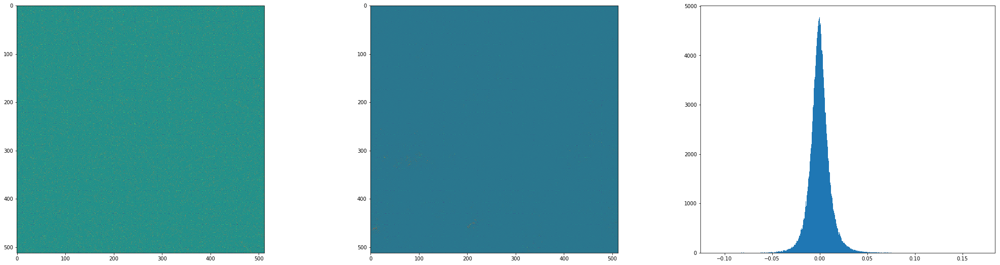

In [54]:
for i in range(np.size(wav_k)):
    print(wav_k[i])
    merge  = list(itertools.chain.from_iterable(wt[i,:,:].real))
    mergedlo  = list(itertools.chain.from_iterable(wtfb[i,:,:].real))
    
    #merge=merge-np.mean(merge)
    #merge=merge/np.std(merge)
    
    #mergedlo=mergedlo-np.mean(mergedlo)
    #mergedlo=mergedlo/np.std(mergedlo)
    
    figure(figsize=(48,9))
    plt.subplot(1,4,1)
    imshow(wt[i,:,:].real)
    plt.subplot(1,4,2)
    imshow(wtfb[i,:,:].real)
    plt.subplot(1,4,3)
    #plt.hist(merge,bins='auto')
    #plt.axis([-2, 2, 0, 3000])

    #plt.subplot(1,4,4)
    plt.hist(mergedlo,bins='auto')
    plt.show()